In [36]:
import os
import numpy as np
import torch
from pathlib import Path
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from matplotlib import colors
import sys
from tqdm import tqdm
import pandas as pd
import random
import h5py
from typing import List, Dict, Union

# Add parent directory to path for imports
sys.path.append(os.path.abspath(os.path.join(os.getcwd(), '../../../NN/ptychosaxsNN/')))
import utils.ptychosaxsNN_utils as ptNN_U
import importlib
importlib.reload(ptNN_U)

import utils.Scan_Plotter as SP
importlib.reload(SP)

plt.rcParams["image.cmap"] = "jet"

In [74]:
# Add the models directory to the path
sys.path.append(os.path.abspath(os.path.join(os.getcwd(), '../../src/models/')))

# First, try to import the module
try:
    import encoder1_no_Unet
    # Force reload the module
    importlib.reload(encoder1_no_Unet)
    # Now import the class from the freshly reloaded module
    from encoder1_no_Unet import recon_model
    print("Successfully imported recon_model")
except Exception as e:
    print(f"Import error: {e}")
    
# First, try to import the module
try:
    import encoder1
    importlib.reload(encoder1)
    # Now import the class from the freshly reloaded module
    from encoder1 import recon_model as recon_model2
    print("Successfully imported recon_model")
except Exception as e:
    print(f"Import error: {e}")


base_path=Path("/net/micdata/data2/12IDC/ptychosaxs/")


files=[2,10,25,50,100,150,200,250,300,400,500]
#1,2,3,7,10

model_list=[f"best_model_DELETE2_WAXS_MASK_Unet_epoch_{f}_pearson_loss.pth" for f in files]


models=[]
for model in model_list:
    #Load lowest validation loss model
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model_new=recon_model2()
    #model_new=recon_model()
    model_new.load_state_dict(torch.load("/net/micdata/data2/12IDC/ptychosaxs/trained_model/"+model))
    model_new.to(device)

    #put into eval mode
    model_new.eval()
    models.append(model_new)

# model_new2=recon_model()
# model_new2.load_state_dict(torch.load(base_path / "models/best_model_ZCB_9_dr32_no_Unet_117iter.pth"))
# model_new2.to(device)
# model_new2.eval()

Successfully imported recon_model
Successfully imported recon_model


In [6]:
# Example usage
scan_name = 'RC02_R3D'
scan_id = 888
base_path = f'/net/micdata/data2/12IDC/2024_Dec/ptycho/{scan_id:03d}'
print(f'base_path: {base_path}')

result = ptNN_U.check_scan_completeness(base_path, scan_name, f'{scan_id:03d}')

if result['complete']:
    print(f"Scan {scan_id:03d} is complete! All {result['total_expected']} files found.")
else:
    print(f"Scan {scan_id:03d} is incomplete. Found {result['found']} of {result['total_expected']} files ({result['completion_percentage']:.1f}%).")
    print(f"Total files in directory: {result['actual_file_count']}")
    
    # Print first few missing files if any
    if len(result['missing']) > 0:
        print("\nMissing files:")
        for file in result['missing'][:]:
            print(f"  - {os.path.basename(file)}")
        
    # Print unexpected files
    if len(result['unexpected_files']) > 0:
        print("\nUnexpected files (don't match the pattern):")
        for file in result['unexpected_files']:
            print(f"  - {os.path.basename(file)}")

base_path: /net/micdata/data2/12IDC/2024_Dec/ptycho/888
Scan 888 is incomplete. Found 936 of 1044 files (89.7%).
Total files in directory: 962

Missing files:
  - RC02_R3D_888_00027_00001.h5
  - RC02_R3D_888_00027_00002.h5
  - RC02_R3D_888_00027_00003.h5
  - RC02_R3D_888_00027_00004.h5
  - RC02_R3D_888_00027_00005.h5
  - RC02_R3D_888_00027_00006.h5
  - RC02_R3D_888_00027_00007.h5
  - RC02_R3D_888_00027_00008.h5
  - RC02_R3D_888_00027_00009.h5
  - RC02_R3D_888_00027_00010.h5
  - RC02_R3D_888_00027_00011.h5
  - RC02_R3D_888_00027_00012.h5
  - RC02_R3D_888_00027_00013.h5
  - RC02_R3D_888_00027_00014.h5
  - RC02_R3D_888_00027_00015.h5
  - RC02_R3D_888_00027_00016.h5
  - RC02_R3D_888_00027_00017.h5
  - RC02_R3D_888_00027_00018.h5
  - RC02_R3D_888_00027_00019.h5
  - RC02_R3D_888_00027_00020.h5
  - RC02_R3D_888_00027_00021.h5
  - RC02_R3D_888_00027_00022.h5
  - RC02_R3D_888_00027_00023.h5
  - RC02_R3D_888_00027_00024.h5
  - RC02_R3D_888_00027_00025.h5
  - RC02_R3D_888_00027_00026.h5
  - RC02_

In [11]:
# Read in file that contains scan number, angle and sample name
scan_info = '/net/micdata/data2/12IDC/2024_Dec/indices_phi_samplename.txt'


def get_sample_scans(csv_path, sample_name):
    """
    Get scan information for a specific sample from the CSV file.
    
    Parameters:
    -----------
    csv_path : str
        Path to the CSV file containing scan information
    sample_name : str
        Name of the sample to search for
        
    Returns:
    --------
    df_sample : pandas.DataFrame
        DataFrame containing scan numbers and phi angles for the specified sample
    """
    # Read the CSV file without headers and specify column names
    df = pd.read_csv(csv_path, header=None, 
                     names=['scan_number', 'phi_angle', 'sample_name'])
    
    # Filter rows where sample_name matches
    df_sample = df[df['sample_name'] == sample_name]
    
    # Sort by scan number
    df_sample = df_sample.sort_values('scan_number')
    
    return df_sample


get_sample_scans(scan_info, ' RC02_R3D_')['scan_number'].values




array([ 884,  885,  886,  887,  888,  889,  890,  891,  892,  893,  894,
        895,  896,  897,  898,  899,  900,  901,  902,  903,  904,  905,
        906,  907,  908,  909,  910,  911,  912,  913,  914,  915,  916,
        917,  918,  919,  920,  921,  922,  923,  924,  925,  926,  927,
        928,  929,  930,  931,  932,  933,  934,  935,  936,  937,  938,
        939,  940,  941,  942,  943,  944,  945,  946,  947,  948,  949,
        950,  951,  952,  953,  954,  955,  956,  957,  958,  959,  960,
        961,  962,  963,  964,  965,  966,  967,  968,  969,  970,  971,
        972,  973,  974,  975,  976,  977,  978,  979,  980,  981,  982,
        983,  984,  985,  986,  987,  988,  989,  990,  991,  992,  993,
        994,  995,  996,  997,  998,  999, 1000, 1001, 1002, 1003, 1004,
       1005, 1006, 1007, 1008, 1009, 1010, 1011, 1012, 1013, 1014, 1015,
       1016, 1017, 1018, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1026,
       1027, 1028, 1029, 1030, 1031, 1032, 1033, 10

In [12]:
# load ZCB_9_3D diffraction data
base_path="/net/micdata/data2/12IDC/2024_Dec/ptycho/"
scan_numbers=[int(scan_id)]#[5101]#[5065]#get_sample_scans(scan_info, ' ZCB_9_3D')['scan_number'].values#[5045,5065,5102,5150]
all_dps=[]
for scan_number in scan_numbers:
    print(f"Loading scan {scan_number}")
    dps=ptNN_U.load_h5_scan_to_npy(base_path, scan_number, plot=False,point_data=True)
    all_dps.append(dps)
all_dps=np.asarray(all_dps)

Loading scan 888


100%|██████████| 962/962 [00:33<00:00, 29.02it/s]


In [13]:
#summed diffraction pattern
print(all_dps.shape)
dp=np.sum(all_dps[0],axis=0)

(1, 962, 1679, 1475)


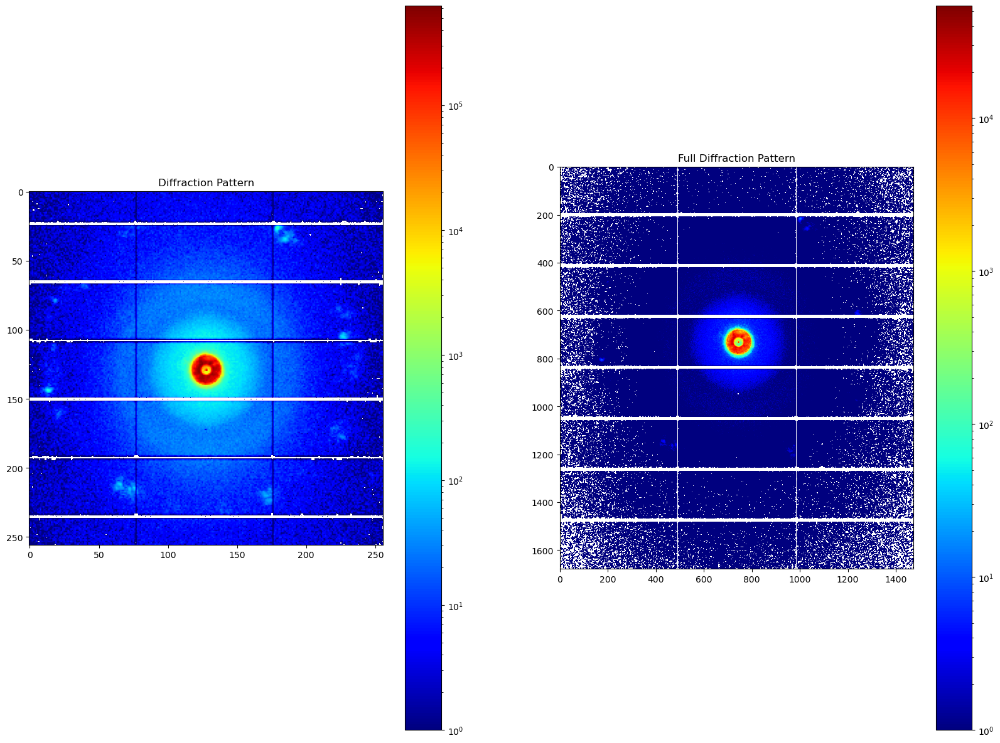

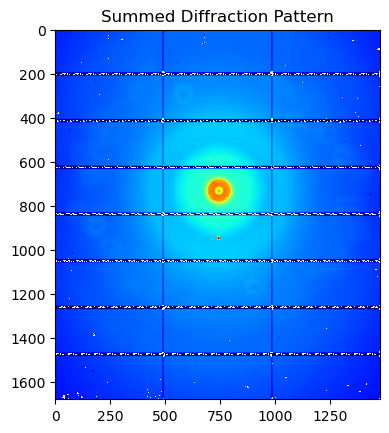

In [30]:
#scan info for ZC4
ncols=37#41#36
nrows=26#31#29
center=(727,743)
index=40
# dps_size = dps[0].shape
# center_offset_y=dps_size[0]//2-center[0]
# center_offset_x=dps_size[1]//2-center[1]

#%%
bin_factor = 256
#crop diffraction patterns
dpsize=1280
# dp=dp[center[0]-dpsize//2:center[0]+dpsize//2,
#     center[1]-dpsize//2:center[1]+dpsize//2]
dp=dps[index][center[0]-dpsize//2:center[0]+dpsize//2,
    center[1]-dpsize//2:center[1]+dpsize//2]

#remove hot pixels
dp[dp >= 2**16-1] = np.min(dp)

dp=ptNN_U.bin_ndarray(dp, (bin_factor, bin_factor), operation='sum')



#plot diffraction patterns
fig, axs = plt.subplots(1, 2, figsize=(20, 15))
im1=axs[0].imshow(dp, cmap='jet',norm=colors.LogNorm())
axs[0].set_title('Diffraction Pattern')
im2=axs[1].imshow(dps[index], cmap='jet',norm=colors.LogNorm())
axs[1].set_title('Full Diffraction Pattern')
plt.colorbar(im1)
plt.colorbar(im2)
plt.show()


#plot diffraction patterns
plt.figure()
plt.imshow(np.sum(dps,axis=0), cmap='jet',norm=colors.LogNorm())
plt.title('Summed Diffraction Pattern')
plt.show()


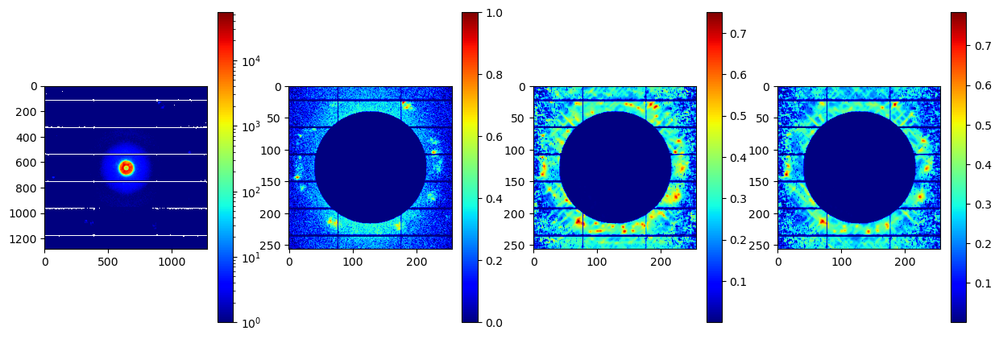

In [75]:
ri=40
selected_model_index=4
mask_large=88
mask_small=64

#preprocess diffraction pattern
#ri=635#635#635#664#random.randint(0,len(dps)-1)
dp=dps[ri][center[0]-dpsize//2:center[0]+dpsize//2,
    center[1]-dpsize//2:center[1]+dpsize//2]
dp_pp=ptNN_U.bin_ndarray(dp, (bin_factor, bin_factor), operation='mean')
mask = np.load('/home/beams/PTYCHOSAXS/deconvolutionNN/data/mask/mask_RC02_R3D_1280.npy')

def create_circular_waxs_mask_min_value(image, radius):
    """
    Create a modified version of the image where the central region is set to the minimum value.
    
    Args:
        image (ndarray): Input image to be masked
        radius (int): Radius of the central circular region to modify
        
    Returns:
        ndarray: Image with central circle set to minimum value
    """
    # Create a copy of the image
    masked_image = image.copy()
    
    # Find minimum value in the image (excluding zeros or NaNs if needed)
    valid_pixels = image[image > 0]  # Adjust if needed
    if len(valid_pixels) > 0:
        min_val = np.min(valid_pixels)
    else:
        min_val = 0
    
    # Create the circular mask
    h, w = image.shape
    y, x = np.indices((h, w))
    center_y, center_x = h // 2, w // 2
    distance_from_center = np.sqrt((x - center_x) ** 2 + (y - center_y) ** 2)
    
    # Set central region to minimum value
    central_region = (distance_from_center <= radius)
    masked_image[central_region] = min_val
    
    return masked_image,central_region

dp_pp=dp_pp*(~create_circular_waxs_mask_min_value(dp_pp,mask_large)[1])

resultT, sfT, bkgT = ptNN_U.preprocess_CMT(dp_pp,mask,radius=200)
resultT=resultT**(1)

#plot diffraction pattern and deconvolved pattern
fig,ax=plt.subplots(1,4,figsize=(15,5))
im1=ax[0].imshow(dp,norm=colors.LogNorm(),cmap='jet')
im2=ax[1].imshow(resultT[0][0],cmap='jet')
im3=ax[2].imshow(model_new(resultT.to(device=device, dtype=torch.float)).detach().to("cpu").numpy()[0][0],cmap='jet')
im4=ax[3].imshow(models[selected_model_index](resultT.to(device=device, dtype=torch.float)).detach().to("cpu").numpy()[0][0],cmap='jet')

plt.colorbar(im1)
plt.colorbar(im2)
plt.colorbar(im3)
plt.colorbar(im4)
plt.show()




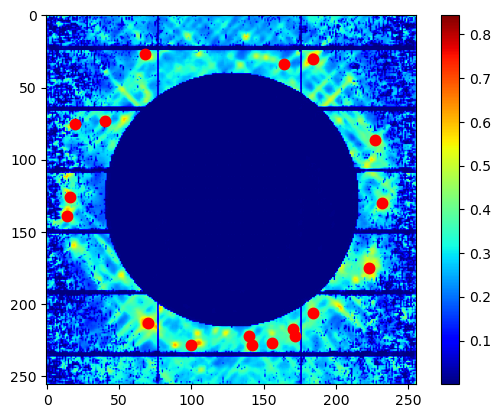

In [69]:
# Get the model output as a 2D array
model_output = model_new(resultT.to(device=device, dtype=torch.float)).detach().to("cpu").numpy()[0][0]

# Find local maxima using maximum_filter
from scipy.ndimage import maximum_filter
from scipy.ndimage import generate_binary_structure, binary_erosion

def find_peaks(image, 
               neighborhood_size=8, 
               neighborhood_connectivity=2,
               threshold=None,
               border_value=10):
    """
    Find peaks in a 2D image using local maxima detection.
    
    Parameters:
    -----------
    image : 2D numpy array
        Input image to find peaks in
    neighborhood_size : int
        Size of the neighborhood for local maxima detection
    neighborhood_connectivity : int
        Connectivity of the neighborhood structure (1 or 2)
    threshold : float or None
        Minimum value for a peak to be considered valid. If None, uses min value
    border_value : int
        Value to use for border pixels during erosion
    
    Returns:
    --------
    peak_coords : tuple of arrays
        (y_coordinates, x_coordinates) of detected peaks
    """
    # Generate neighborhood structure
    neighborhood = generate_binary_structure(2, neighborhood_connectivity)
    
    # Find local maxima
    local_max = maximum_filter(image, size=neighborhood_size) == image
    
    # Apply threshold if specified
    if threshold is not None:
        local_max = local_max & (image > threshold)
    
    # Remove background
    background = (image == np.min(image))
    eroded_background = binary_erosion(background, structure=neighborhood, border_value=border_value)
    detected_peaks = local_max & ~eroded_background
    
    return np.where(detected_peaks)

# Example usage with default parameters
peak_coords = find_peaks(model_output,threshold=0.62,neighborhood_size=8)

# Create figure with peaks overlaid
plt.figure()
plt.imshow(model_output, cmap='jet')
plt.plot(peak_coords[1], peak_coords[0], 'r.', markersize=15)
plt.colorbar()
plt.show()

# Example of using different parameters
# peak_coords = find_peaks(model_output, 
#                         neighborhood_size=12,  # Larger neighborhood
#                         neighborhood_connectivity=1,  # 4-connected neighborhood
#                         threshold=0.5,  # Only peaks above 0.5
#                         border_value=5)  # Different border value

In [76]:
dps.shape


(1476, 1679, 1475)

In [80]:
# Choose the model to apply
index=-1
model_type='Unet'
normalize=True
Niter=files[index]
model_applied=models[index]

print("Creating plotter...")
plotter = SP.Scan_Plotter(dps, ptNN_U.preprocess_CMT, mask*~create_circular_waxs_mask_min_value(mask,88)[1], model_applied, scanx=41, scany=31,center=center,dpsize=1024)
print("Normalizing patterns...")
plotter.normalize_patterns(mode=['preprocessed', 'model'], method='subtract_first')

Creating plotter...
Normalizing patterns...
Calculating normalization factors...


  0%|          | 0/1476 [00:00<?, ?it/s]

100%|██████████| 1476/1476 [00:21<00:00, 67.29it/s]


Plotting full scan...


100%|██████████| 1271/1271 [00:00<00:00, 1305.95it/s]


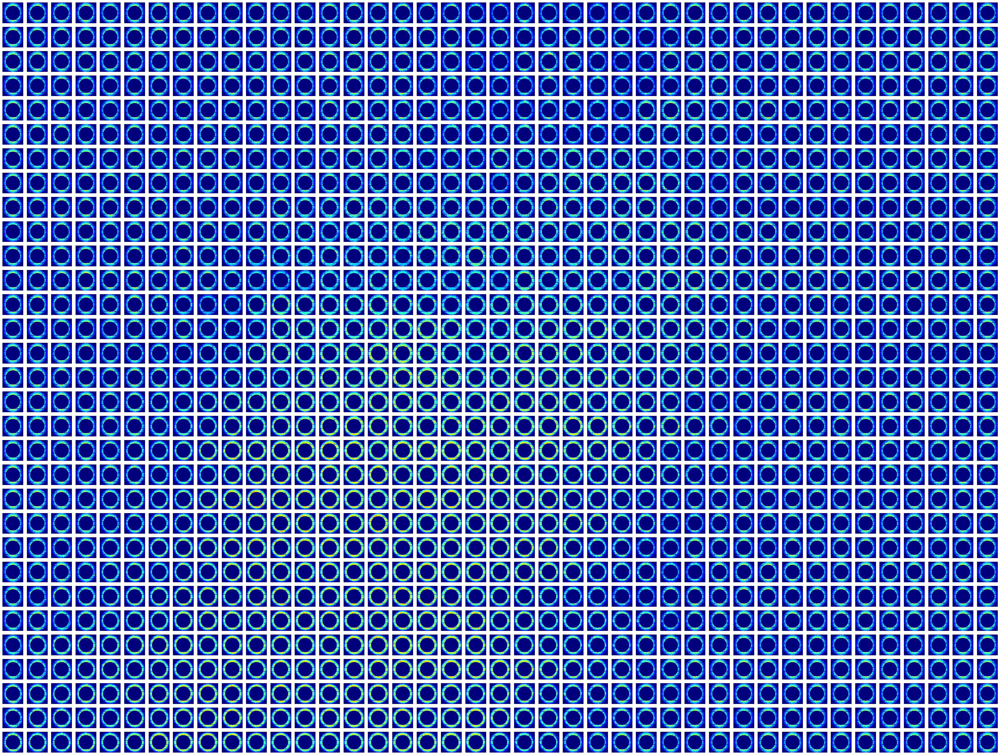

Plotting absorption map...


100%|██████████| 1271/1271 [00:00<00:00, 7423.09it/s]


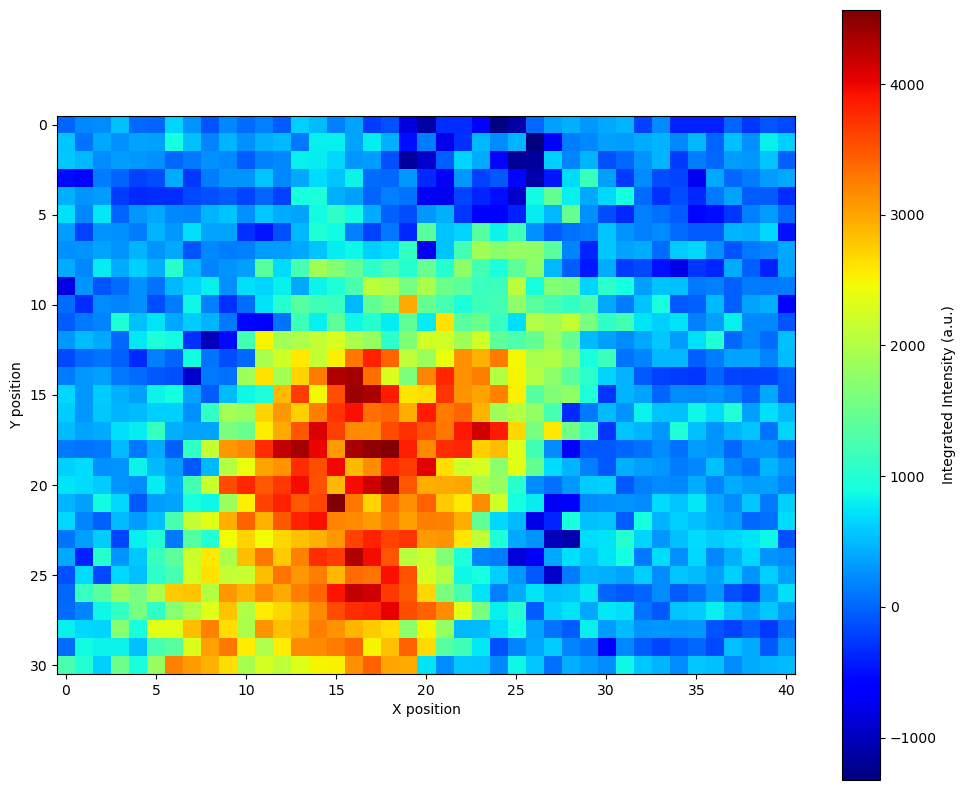

Plotting azimuthal segments...
Processing diffraction patterns...


100%|██████████| 1271/1271 [00:00<00:00, 1189150.21it/s]

Creating segment maps...


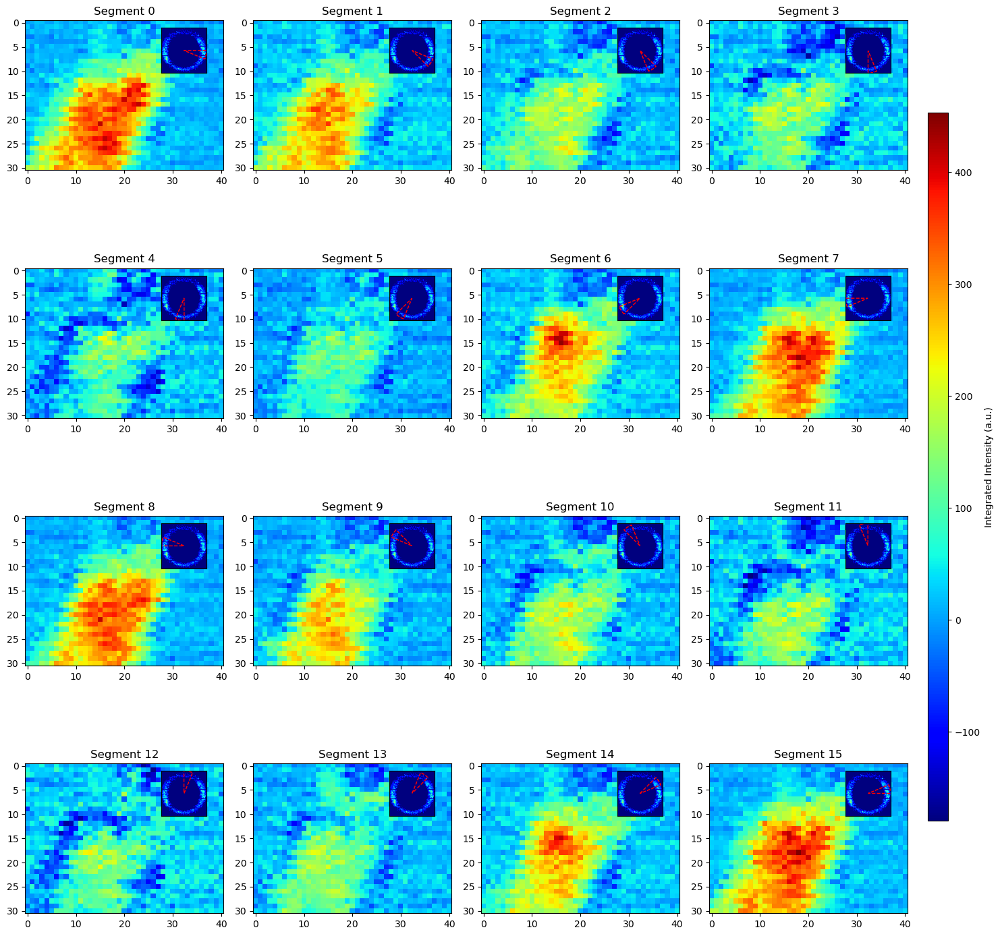

In [81]:
print("Plotting full scan...")
fig=plotter.plot_full_scan(mode='preprocessed',log_scale=False)
#fig.savefig('full_scan_preprocessed.png')

print("Plotting absorption map...")
absorption_map_preprocessed=plotter.plot_absorption_map(mode='preprocessed',log_scale=False,normalized=normalize)
#absorption_map_preprocessed[0].savefig('absorption_map_preprocessed.png')

print("Plotting azimuthal segments...")
segment_map = plotter.plot_all_azimuthal_segments(num_segments=16, inner_radius=0, 
                                   outer_radius=128, example_idx=635,
                                   mode='preprocessed',log_scale=False,normalized=normalize)
#segment_map[0].savefig('segment_map_preprocessed.png')


Plotting full scan...


100%|██████████| 1271/1271 [00:00<00:00, 1709.54it/s]


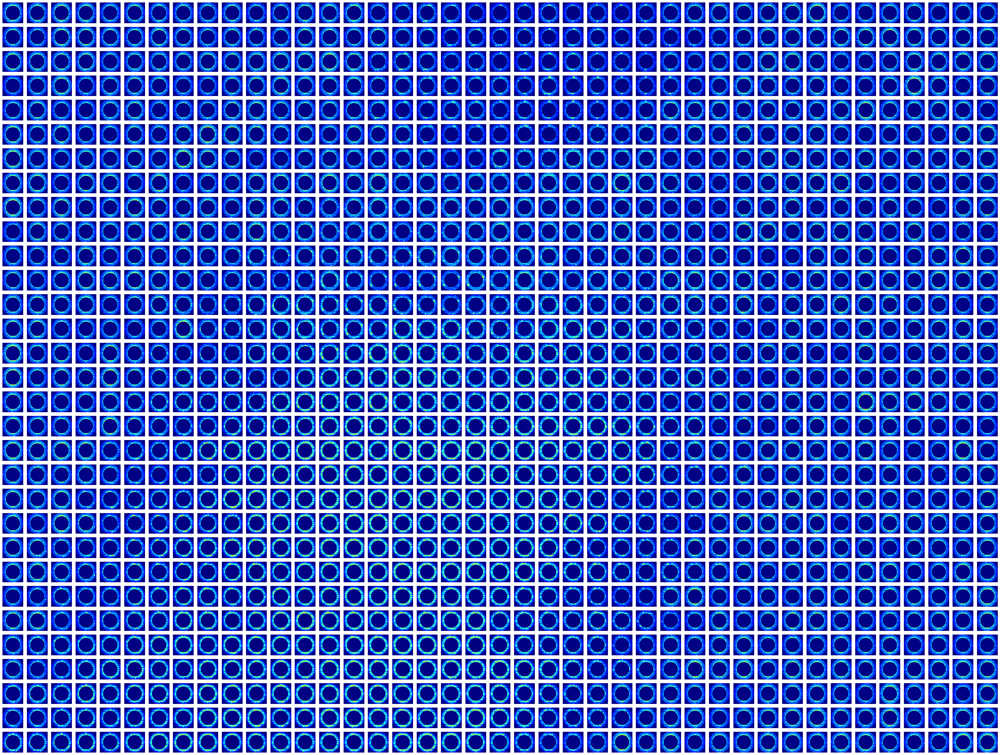

Plotting absorption map...


100%|██████████| 1271/1271 [00:00<00:00, 12425.73it/s]


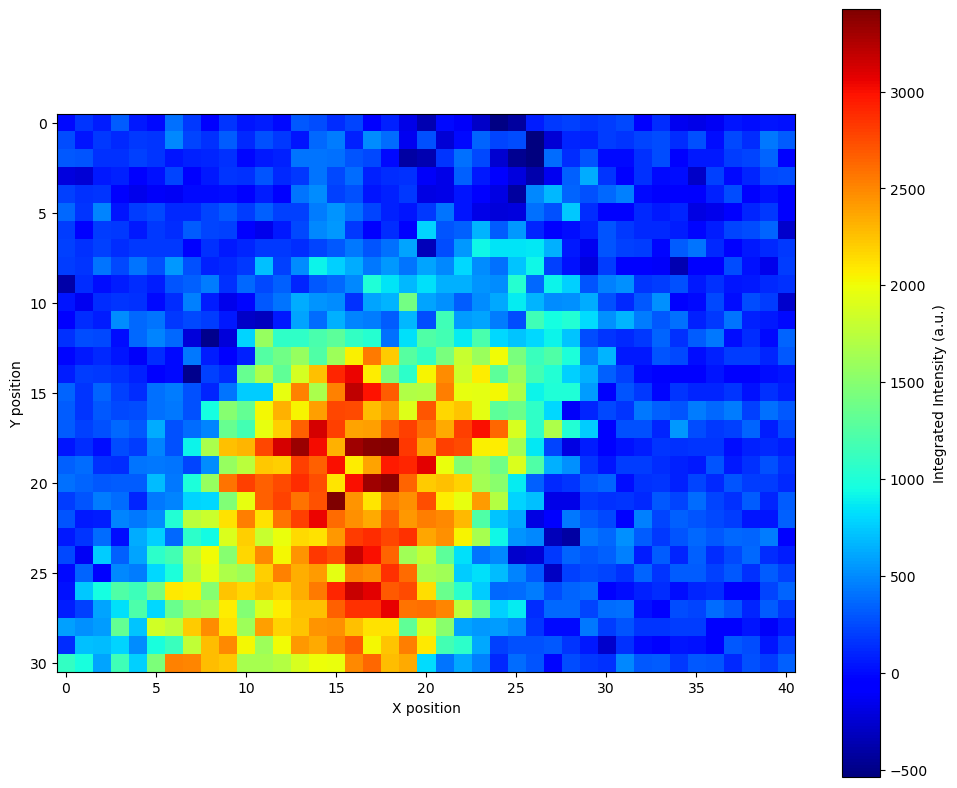

Plotting azimuthal segments...
Processing diffraction patterns...


100%|██████████| 1271/1271 [00:00<00:00, 672591.52it/s]

Creating segment maps...


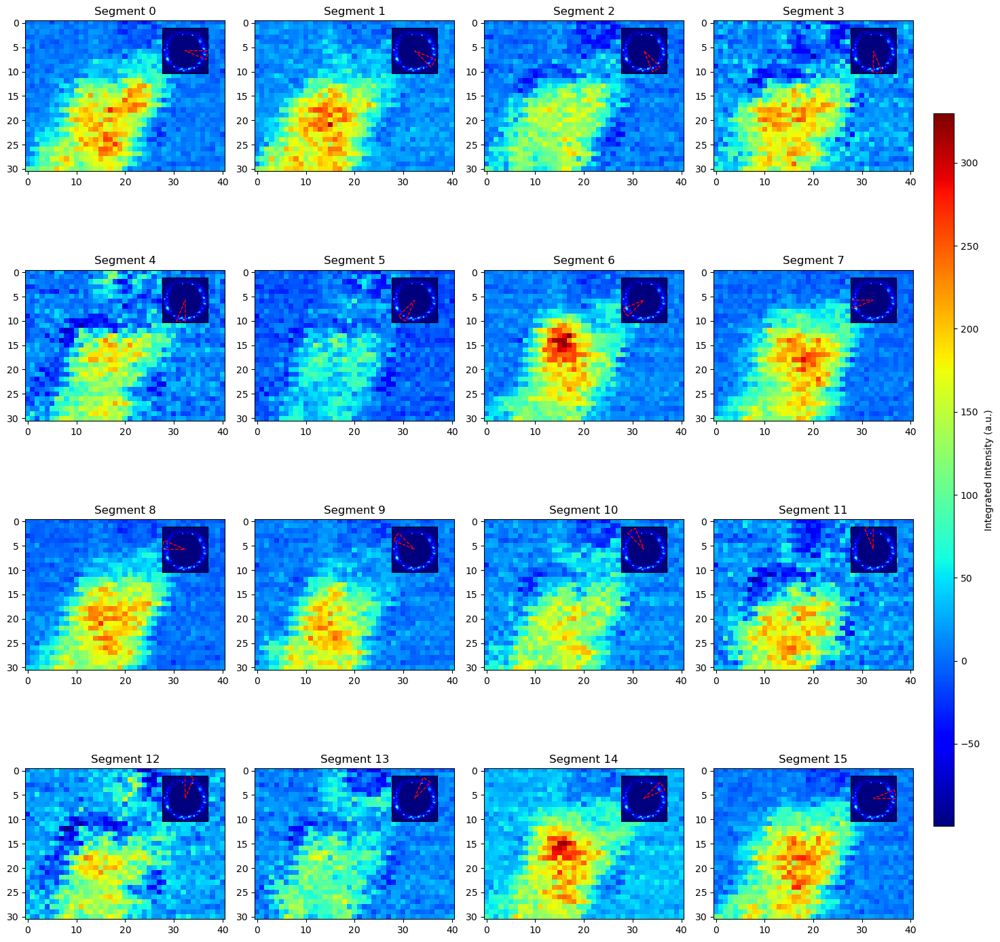

In [82]:
print("Plotting full scan...")
fig_model=plotter.plot_full_scan(mode='model',log_scale=False)
#fig_model.savefig('full_scan_model_'+model_type+'_'+str(Niter)+'.png')

print("Plotting absorption map...")
absorption_map_model=plotter.plot_absorption_map(mode='model',log_scale=False,normalized=normalize)
#absorption_map_model[0].savefig('absorption_map_model_'+model_type+'_'+str(Niter)+'.png')

print("Plotting azimuthal segments...")
segment_map_model = plotter.plot_all_azimuthal_segments(num_segments=16, inner_radius=0, 
                                   outer_radius=128, example_idx=635,
                                   mode='model',log_scale=False,normalized=normalize)
#segment_map_model[0].savefig('segment_map_model_'+model_type+'_'+str(Niter)+'.png')
